In [1]:
import os
import sys
import util
import pickle
import subprocess
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from geopy.distance import geodesic
from datetime import datetime
from tqdm import tqdm

is_windows = sys.platform.lower() not in ['darwin', 'linux']
proj_lib = subprocess.check_output(['where' if is_windows else 'which', 'python'])
proj_lib = proj_lib.decode('utf-8').split('\n')[0].split(os.path.sep)
if is_windows:
    proj_lib = os.path.join(proj_lib[0], os.path.sep, *proj_lib[1:-1], 'share', 'proj')
else:
    proj_lib = os.path.join(os.path.sep, *proj_lib[:-2], 'share', 'proj')
os.environ['PROJ_LIB'] = proj_lib

from mpl_toolkits.basemap import Basemap
# conda install -c conda-forge basemap
# conda install -c conda-forge basemap-data-hires
# conda install -c conda-forge proj4
# conda install pyproj

In [2]:
# folders where the mass flow readings and wind data are imported
folders = ['apr2020', 'may2020', 'jun2020', 'jul2020', 'aug2020', 'sep2020', 'oct2020']
# folders where the location data is imported
location_data = ['location1.csv', 'location2.csv']
# each second
resampling = '1S'
# time frame, six months: 22 April 2020 to 22 October 2020
mask = lambda df: (df.index >= datetime(year=2020, month=4, day=22)) & (df.index < datetime(year=2020, month=10, day=23))


In [3]:
# Mass Flow Readings (Bunker)

In [4]:
mflo1 = util.parse_raw(folders, ['mflo1'])
mflo2 = util.parse_raw(folders, ['mflo2'])

  0%|          | 44/27252 [00:00<01:02, 438.42it/s]files not parsed:
sep2020/v1_200905_184918.pkl
sep2020/v1_200919_183258.pkl
sep2020/v1_200905_235501.pkl
100%|██████████| 27252/27252 [01:02<00:00, 434.13it/s]
files not parsed:
sep2020/v1_200905_184918.pkl
sep2020/v1_200919_183258.pkl
sep2020/v1_200905_235501.pkl


In [5]:
mflo1 = mflo1.loc[mask(mflo1)]
mflo2 = mflo2.loc[mask(mflo2)]

In [7]:
mflow = mflo1.join(mflo2)

In [8]:
mflow

,mflo1,mflo2
2020-04-22 01:30:19.469000101,0.000,NaN
2020-04-22 01:30:19.480000019,0.000,NaN
2020-04-22 01:30:20.588999987,0.006,NaN
2020-04-22 01:30:20.589999914,0.006,NaN
2020-04-22 01:30:21.684000015,0.004,NaN
...,...,...
2020-10-22 23:39:22.010999918,0.014,NaN
2020-10-22 23:39:24.005000114,0.014,NaN
2020-10-22 23:39:24.006000042,0.014,NaN
2020-10-22 23:39:25.997999907,0.013,NaN


In [13]:
with open('unfiltered.pkl', 'wb') as f:
    pickle.dump(mflow, f)

In [7]:
mflo1.to_csv('mflo1.csv')
mflo2.to_csv('mflo2.csv')

In [10]:
%%time

# parse main engine 1 reading
mflo1 = util.parse_raw(folders, ['mflo1'])
mflo1 = mflo1.loc[mask(mflo1)]
mflo1_unfiltered = mflo1
# filter noise
mflo1 = util.filter_signal(mflo1)
# resample (mean) to resampling frequency
mflo1 = mflo1.resample(resampling).mean()

100%|██████████| 27252/27252 [01:02<00:00, 438.18it/s]
files not parsed:
sep2020/v1_200905_184918.pkl
sep2020/v1_200919_183258.pkl
sep2020/v1_200905_235501.pkl
CPU times: user 1min 20s, sys: 1.92 s, total: 1min 22s
Wall time: 1min 21s


In [11]:
%%time

# parse main engine 2 reading
mflo2 = util.parse_raw(folders, ['mflo2'])
mflo2 = mflo2.loc[mask(mflo2)]
mflo2_unfiltered = mflo2
# filter noise
mflo2 = util.filter_signal(mflo2)
# resample (mean) to resampling frequency
mflo2 = mflo2.resample(resampling).mean()

100%|██████████| 27252/27252 [01:04<00:00, 425.18it/s]
files not parsed:
sep2020/v1_200905_184918.pkl
sep2020/v1_200919_183258.pkl
sep2020/v1_200905_235501.pkl
CPU times: user 1min 22s, sys: 1.74 s, total: 1min 24s
Wall time: 1min 23s


In [12]:
%%time

# join both bunker readings, then drop (MUST) before forward will
mflow = mflo1.join(mflo2)
mflow = mflow.dropna(thresh=1)
mflow = mflow.fillna(method='ffill')

CPU times: user 3.6 s, sys: 361 ms, total: 3.96 s
Wall time: 3.97 s


In [9]:
mflow


,mflo1,mflo2
2020-04-22 01:30:19,NaN,0.004
2020-04-22 01:30:20,0.006,0.004
2020-04-22 01:30:21,0.004,0.004
2020-04-22 01:30:22,0.004,0.004
2020-04-22 01:30:23,0.004,0.004
...,...,...
2020-10-22 23:39:21,0.013,0.013
2020-10-22 23:39:22,0.014,0.013
2020-10-22 23:39:23,0.014,0.011
2020-10-22 23:39:24,0.014,0.011


In [14]:
t_delta = (mflow.index[1:]-mflow.index[:-1]).seconds
mflow = mflow.iloc[1:]
mflow['t_delta'] = t_delta

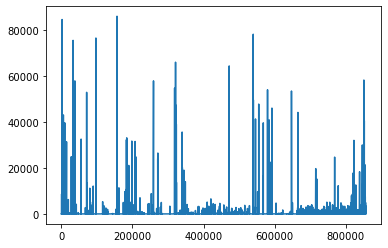

In [17]:
mflow['t_delta'].reset_index(drop=True).plot();

In [166]:
gap = 240
min_data_pts = 0.5
segments = []

gaps = mflow.loc[mflow['t_delta'] > gap].index.to_list()
gaps = zip(mflow.index[:1].to_list() + gaps, gaps + mflow.index[-1:].to_list())
for bgn, end in gaps:
    seg = mflow.loc[(mflow.index >= bgn) & (mflow.index < end), ('mflo1', 'mflo2')]
    if (seg.index[-1]-seg.index[0]).seconds >= gap and seg.shape[0] >= min_data_pts * gap:
        seg.index = seg.index.tz_localize('Asia/Singapore')
        seg = seg.resample('1S').ffill()
        seg[seg < 0] = 0
        segments.append(seg)
print('number of segments:', len(segments))

number of segments: 1002


                           mflo1  mflo2
2020-04-22 01:30:21+08:00  0.004  0.004
2020-04-22 01:30:22+08:00  0.004  0.004
2020-04-22 01:30:23+08:00  0.004  0.004
2020-04-22 01:30:24+08:00  0.005  0.004
2020-04-22 01:30:25+08:00  0.006  0.004
...                          ...    ...
2020-04-22 01:46:06+08:00  0.003  0.003
2020-04-22 01:46:07+08:00  0.003  0.003
2020-04-22 01:46:08+08:00  0.003  0.003
2020-04-22 01:46:09+08:00  0.003  0.003
2020-04-22 01:46:10+08:00  0.000  0.003

[950 rows x 2 columns] (950, 2)


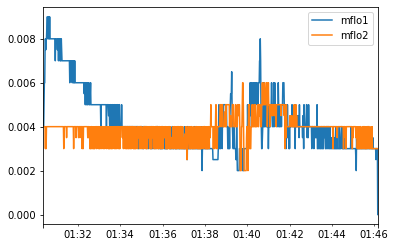

In [77]:
for segment in segments:
    segment.plot();
    print(segment, segment.shape)
    break

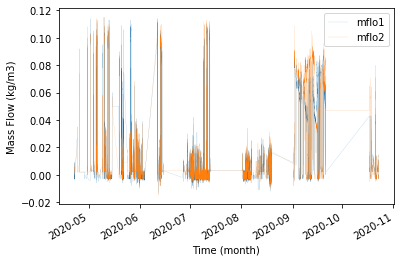

In [10]:
mflow.plot(linewidth=0.1, xlabel='Time (month)', ylabel='Mass Flow (kg/m3)');

# there are gaps (due to inactivity)

In [9]:
# group into segments, to remove in acitivities
# gap: segment separator, the minimum time of inactivity (gap x resampling)
# min_data_points: minimum datapoints, fraction of gap x resampling counts

# segments = util.create_segments(mflow, resampling=resampling, gap=300, min_data_points=0.5)

number of segments: 2549
100%|██████████| 2549/2549 [00:11<00:00, 218.16it/s]
accepted segments: 560


In [163]:
test_segment = 8

In [164]:
# filtered vs original
# originally, there is noise in bunker readings
# it was filtered prior to proceeding

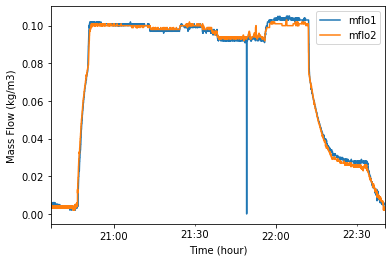

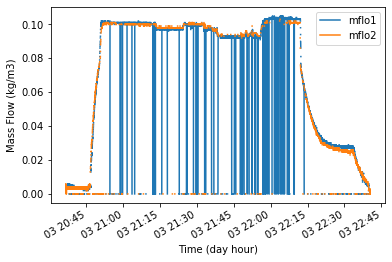

In [167]:
# example from segment
for segment in segments[test_segment:test_segment+1]:
    segment.fillna(method='ffill').plot(ylabel='Mass Flow (kg/m3)', xlabel='Time (hour)');
    time_frame_1 = mflo1_unfiltered.index.tz_localize('Asia/Singapore') >= segment.index[0]
    time_frame_1 &= mflo1_unfiltered.index.tz_localize('Asia/Singapore') <= segment.index[-1]
    unfiltered_1 = mflo1_unfiltered.loc[time_frame_1]
    time_frame_2 = mflo2_unfiltered.index.tz_localize('Asia/Singapore') >= segment.index[0]
    time_frame_2 &= mflo2_unfiltered.index.tz_localize('Asia/Singapore') <= segment.index[-1]
    unfiltered_2 = mflo2_unfiltered.loc[time_frame_2]
    unfiltered = unfiltered_1.join(unfiltered_2, how='outer')
    # plt.plot(unfiltered['mflo1'], linewidth=1)
    # plt.plot(unfiltered['mflo2'], linewidth=1)
    # plt.show();
    unfiltered.plot(ylabel='Mass Flow (kg/m3)', xlabel='Time (day hour)');
    pass

In [13]:
# Location Data (Latitude & Longitude)

In [14]:
# original location data is sparse, once in few minutes
# resampling (interpolation) to every second
# geodesic distance (in meter) is calculated between points (lat/lon)
# location data is segmented conforming bunker segments

In [83]:
# interval: 1 second

segments_location = util.find_segments_location(segments, location_data, interval=1)

100%|██████████| 1002/1002 [05:50<00:00,  2.86it/s]


In [84]:
segments_location[test_segment]

# _lat & _lon are origin, lat & lon are destination

,_lat,_lon,lat,lon,distance
ts,,,,,
2020-05-03 20:36:37+08:00,1.312618,103.646000,1.312618,103.646000,0.003064
2020-05-03 20:36:38+08:00,1.312618,103.646000,1.312618,103.646000,0.003064
2020-05-03 20:36:39+08:00,1.312618,103.646000,1.312618,103.646000,0.003064
2020-05-03 20:36:40+08:00,1.312619,103.646000,1.312618,103.646000,0.003064
2020-05-03 20:36:41+08:00,1.312619,103.646000,1.312619,103.646000,0.003064
...,...,...,...,...,...
2020-05-03 22:40:26+08:00,1.312835,103.646108,1.312835,103.646108,0.008174
2020-05-03 22:40:27+08:00,1.312835,103.646108,1.312835,103.646108,0.008174
2020-05-03 22:40:28+08:00,1.312835,103.646108,1.312835,103.646108,0.008174


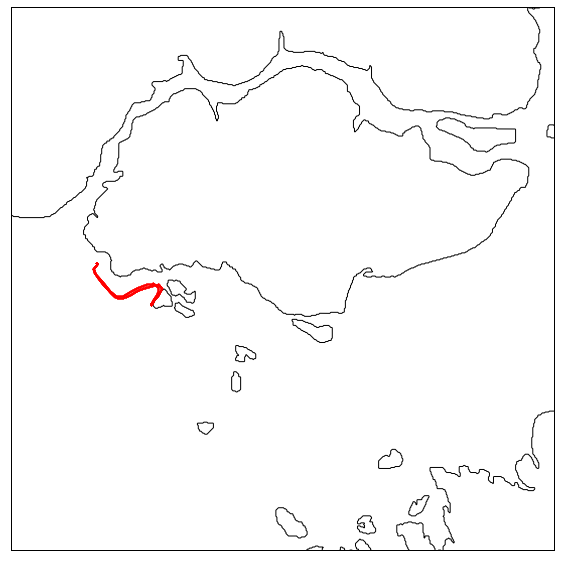

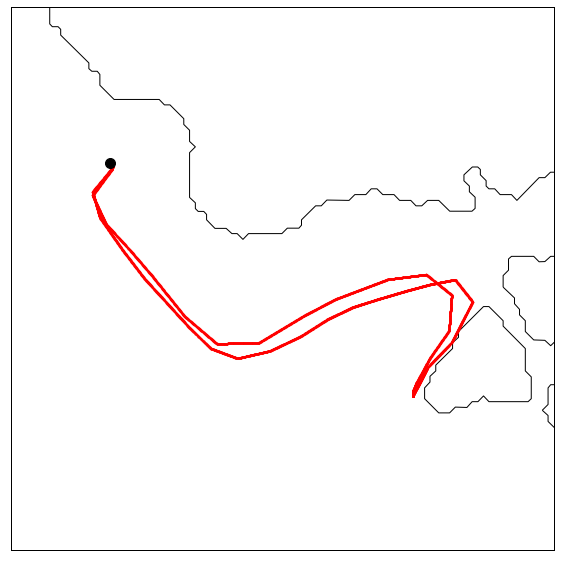

In [85]:
loc = segments_location[test_segment]
lat = loc['_lat'].tolist()[:1] + loc['lat'].tolist()
lon = loc['_lon'].tolist()[:1] + loc['lon'].tolist()
center_lat, center_lon = np.mean([min(lat), max(lat)]), np.mean([min(lon), max(lon)])
span = (geodesic((max(lat), max(lon)), (min(lat), min(lon))).meters // 1000 + 2) * 1000

for i, (s, clat, clon) in enumerate([(5E4, 1.3, 103.8), (span, center_lat, center_lon)]):
    plt.figure(figsize=(10,10))
    m = Basemap(projection='lcc', resolution='f',
                width=s, height=s, 
                lat_0=clat, lon_0=clon)
    m.drawmapboundary(fill_color='white')
    m.drawcoastlines()
    x, y = m(lon, lat)
    if i == 0:
        m.plot(x, y, '.', markersize=0.5, linewidth=0.1, color='r') 
    else:
        m.plot(x, y, 'o-', markersize=1, linewidth=0.5, color='r')
        m.plot(x[0], y[0], 'o-', markersize=10, color='k')
    plt.show()

In [86]:
# Wind and Direction Data

In [87]:
# parsing
# tm001 wind speed
# tm002 wind direction

In [88]:
%%time

param1 = util.parse_raw(folders, ['tm001'])
param1 = param1.loc[mask(param1)]

100%|██████████| 27252/27252 [01:16<00:00, 357.10it/s]
files not parsed:
sep2020/v1_200905_184918.pkl
sep2020/v1_200919_183258.pkl
sep2020/v1_200905_235501.pkl
CPU times: user 2min 9s, sys: 4.82 s, total: 2min 14s
Wall time: 2min 22s


In [89]:
%%time

param2 = util.parse_raw(folders, ['tm002'])
param2 = param2.loc[mask(param2)]

100%|██████████| 27252/27252 [01:08<00:00, 396.77it/s]
files not parsed:
sep2020/v1_200905_184918.pkl
sep2020/v1_200919_183258.pkl
sep2020/v1_200905_235501.pkl
CPU times: user 1min 52s, sys: 3.63 s, total: 1min 56s
Wall time: 1min 57s


In [90]:
%%time

# both wind data is resampled to every second frequency
# 10 bit raw reading (0 - 1023) representing 0 - 100 m/s (non-sustained) wind speed, and 
# 0 - 360 deg (clockwise from bow) wind direction
# wind effect is projected wind speed (m/s) along stern-bow axis, negative is sternward direction

wind = param1.join(param2)
wind = wind.dropna(thresh=1)
wind = wind.resample(resampling).mean().fillna(method='ffill')

wind['speed'] = wind['tm001'] / 1023 * 100
wind['direction'] = wind['tm002'] / 1023 * 360 % 360
wind = wind.drop(columns=['tm001', 'tm002'])
wind = wind.dropna(thresh=2)
# wind['timedelta'] = (wind.index - wind.index[0]).seconds
wind['effect'] = np.sin(np.deg2rad((wind['direction'] - 270) % 360)) * wind['speed']
wind.index = wind.index.tz_localize('Asia/Singapore')

CPU times: user 5.55 s, sys: 1.08 s, total: 6.63 s
Wall time: 6.62 s


In [91]:
# group wind data into segments, conforming bunker segments
# wind effect is offset by vessel movement (distance / second)

segments_wind = []
for segment, location in tqdm(zip(segments, segments_location), total=len(segments)):
    bgn, end = wind.index >= segment.index[0], wind.index <= segment.index[-1]
    locale = wind.loc[bgn & end]
    # offset wind from own movement
    locale['effect'] = locale['effect'] + location['distance']
    segments_wind.append(locale)

100%|██████████| 1002/1002 [00:57<00:00, 17.52it/s]


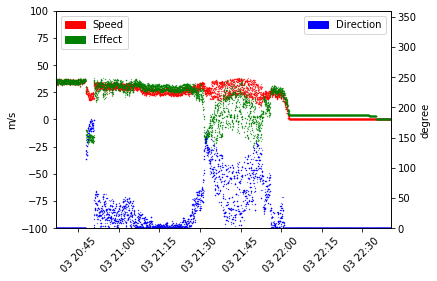

In [92]:
for ws in segments_wind[test_segment:test_segment+1]:
    fig = plt.figure()
    ax1 = fig.add_subplot(111)
    plt.xticks(rotation=45)
    plt.ylabel('m/s')
    plt.ylim((-100, 100))
    ax1.scatter(ws.index, ws['speed'], s=0.05, c='r')
    ax1.scatter(ws.index, ws['effect'], s=0.05, c='g')
    ax1.legend(handles=[mpatches.Patch(color='r', label='Speed'), mpatches.Patch(color='g', label='Effect')], loc='upper left')
    ax2 = ax1.twinx()
    plt.ylabel('degree')
    plt.ylim((0, 360))
    ax2.scatter(ws.index, ws['direction'], s=0.05, c='b')
    ax2.legend(handles=[mpatches.Patch(color='b', label='Direction')], loc='upper right')
    plt.xlim((ws.index[0], ws.index[-1]))
    plt.xlabel('Time (day hour)')
    plt.show();

In [93]:
# indices

In [94]:
# check irregularities
idx_mflow = [segment.index.to_numpy() for segment in segments]
idx_wind = [segment.index.to_numpy() for segment in segments_wind]
idx_loc = [segment.index.to_numpy() for segment in segments_location]
is_irregular = True in list(map(lambda z: False in ((z[0] == z[1]) & (z[1] == z[2]) & (z[2] == z[0])), zip(idx_mflow, idx_wind, idx_loc)))
if is_irregular:
    print('segments NOT aligned')
else:
    print('segments are aligned')
    indices = idx_mflow

segments are aligned


In [95]:
# save checkpoint

with open('dataset.pkl', 'wb') as f:
    pickle.dump({'index': indices, 'bunker': segments, 'wind': segments_wind, 'location': segments_location}, f)

In [96]:
# continue

In [97]:
import util
import pickle
import matplotlib.pyplot as plt

In [98]:
with open('dataset.pkl', 'rb') as f:
    ds = pickle.load(f)
indices, segments, segments_wind, segments_location = ds['index'], ds['bunker'], ds['wind'], ds['location']
len(indices)

1002

In [99]:
# check irregularities
idx_mflow = [segment.index.to_numpy() for segment in segments]
idx_wind = [segment.index.to_numpy() for segment in segments_wind]
idx_loc = [segment.index.to_numpy() for segment in segments_location]
is_irregular = True in list(map(lambda z: False in ((z[0] == z[1]) & (z[1] == z[2]) & (z[2] == z[0])), zip(idx_mflow, idx_wind, idx_loc)))
if is_irregular:
    print('segments NOT aligned')
else:
    print('segments are aligned')

segments are aligned


In [100]:
%%time

n_class = 100

# signals: input (in array), scores: output, estimators: TimeSeriesKMeans estimator
# each has three elements (bunker, wind, distance)

signals, scores, estimators = util.get_scores(segments, segments_wind, segments_location, 
                                              stride=15, 
                                              time_constant=60, 
                                              n_cluster=n_class)

# save checkpoint
with open('scores.pkl', 'wb') as f:
    pickle.dump((signals, scores, estimators), f)

CPU times: user 4min 19s, sys: 2.25 s, total: 4min 21s
Wall time: 3min 54s


In [101]:
# continue

In [102]:
import util
import pickle
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans, DBSCAN, MiniBatchKMeans, AgglomerativeClustering, MeanShift
from concurrent.futures import ProcessPoolExecutor, as_completed
from sklearn.preprocessing import normalize
from scipy.ndimage import gaussian_filter
from operator import itemgetter
from sklearn.metrics import auc
from tqdm import tqdm

In [130]:
with open('scores.pkl', 'rb') as f:
    signals, scores, estimators = pickle.load(f)

n_class = 100

In [131]:
test_segment = 8

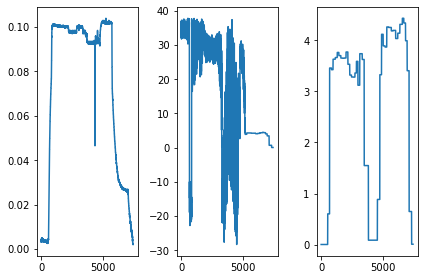

In [132]:
# signals[0] is signal's element 0: bunker
# example from segment #8
# x: time (n seconds), y: bunker in kg/m3

plt.subplot(1, 3, 1)
plt.plot(signals[0][test_segment])
plt.subplot(1, 3, 2)
plt.plot(signals[1][test_segment])
plt.subplot(1, 3, 3)
plt.plot(signals[2][test_segment])
plt.tight_layout()
plt.show();

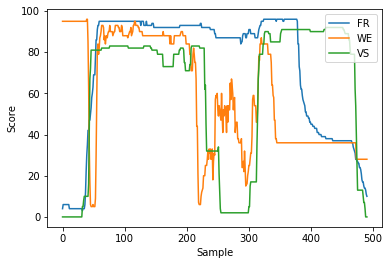

In [133]:
plt.plot(scores[0][test_segment], label='FR');
plt.plot(scores[1][test_segment], label='WE');
plt.plot(scores[2][test_segment], label='VS');
plt.ylabel('Score')
plt.xlabel('Sample')
plt.legend(loc='upper right')
plt.show();

# x: counts, period (time_constant: 60 seconds), stride: 15 seconds (overlap: 60-15 = 45 seconds)
# y: bunker score (maximum is equal to n_class)

In [134]:
# test segment is not exclude from HMM (hidden markov model) training
# test segment is not included in dataset either, will be later for test
# apply bias, assign epsilon

In [135]:
%%time

# bias is for stretching/squeezing a particular axial space 
# to purposefully make points closer or away
# lower is closer
biases = [1, 1, 1]
# epsilon is minimum distance of outermost cluster point to the next unclustered point 
# to absorb as cluster member
epsilon = np.sqrt(8)

# create datapoints, and apply bias
b = np.array([score for enum, score in enumerate(scores[0]) if enum != test_segment])
b = np.concatenate(b * biases[0])
w = np.array([score for enum, score in enumerate(scores[1]) if enum != test_segment])
w = np.concatenate(w * biases[1])
d = np.array([score for enum, score in enumerate(scores[2]) if enum != test_segment])
d = np.concatenate(d * biases[2])
datapoints = np.array([b, w, d]).T

CPU times: user 14.5 ms, sys: 196 µs, total: 14.7 ms
Wall time: 12.9 ms


In [136]:
# new

In [137]:
n_cluster = 300
infinite_breaker = 1000
cluster_quality_thresh = 1

In [138]:
%%time

# k-means
n_cluster_ = n_cluster
cluster_centers = []
while True:
    if n_cluster_ > infinite_breaker:
        print('optimum not found')
        break
    # create clusters, without noise points
    est = KMeans(n_clusters=n_cluster_, n_jobs=-1)
    est.fit(datapoints)

    # inverse mean square error
    dfunc = lambda i: np.linalg.norm(datapoints[est.labels_==i] - est.cluster_centers_[i], axis=1)
    cluster_quality = np.array([dfunc(j) for j in range(n_cluster_)])
    cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])
    # cluster labels accepted
    accepted = cluster_quality>=cluster_quality_thresh

    if not np.all(accepted):
        print(f"n_cluster: {n_cluster_}, minimum: {np.min(cluster_quality)}")
        n_cluster_ += 5
    else:
        break

# mean shift
# est = MeanShift(bandwidth=9, 
#                 # cluster_all=False, 
#                 n_jobs=-1).fit(datapoints)

print('\nnumber of clusters:', est.cluster_centers_.shape[0], '\n')
n_cluster = est.cluster_centers_.shape[0]

n_cluster: 300, minimum: 0.838739948549517
n_cluster: 305, minimum: 0.8750361585189472
n_cluster: 310, minimum: 0.7599553952544144
n_cluster: 315, minimum: 0.8387193779012638
n_cluster: 320, minimum: 0.8724846465823751
n_cluster: 325, minimum: 0.8680368911606512
n_cluster: 330, minimum: 0.8995831521428791
n_cluster: 335, minimum: 0.9169526787183526
n_cluster: 340, minimum: 0.9542993697923275
n_cluster: 345, minimum: 0.9561289563371549

number of clusters: 350 

CPU times: user 1.69 s, sys: 1.49 s, total: 3.17 s
Wall time: 3min 19s


number of member of five smallest clusters: 36 38 55 59 59 



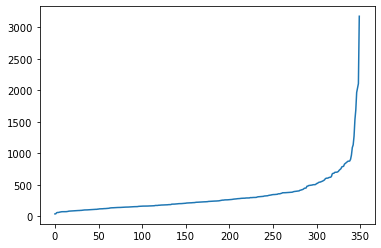

In [139]:
# number of members from each cluster, sorted from low to high
sorted_members = np.array(sorted([est.labels_[est.labels_==i].shape[0] for i in range(np.unique(est.labels_).shape[0])]))
print('number of member of five smallest clusters:', *sorted_members[:5], '\n')
plt.plot(sorted_members);

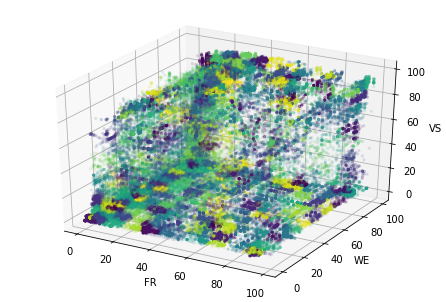

In [140]:
# datapoint_labels = util.associate_to_cluster(datapoints, est.cluster_centers_)
datapoint_labels = est.labels_

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(datapoints[:, 0], datapoints[:, 1], datapoints[:, 2], 
           c=datapoint_labels.astype(float), alpha=0.1, marker='.')
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
fig.show()

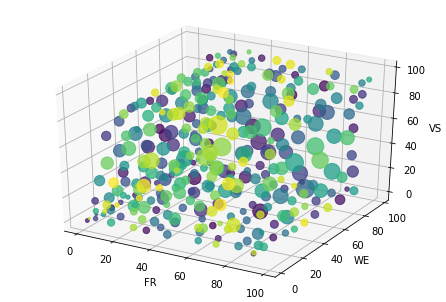

In [141]:
# inverse mean square error
cluster_quality = [np.linalg.norm(datapoints[datapoint_labels==i] - est.cluster_centers_[i], axis=1) for i in range(n_cluster)]
cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(est.cluster_centers_[:, 0], est.cluster_centers_[:, 1], est.cluster_centers_[:, 2], 
           c=np.unique(datapoint_labels).astype(float), alpha=0.75, marker='o', 
           s=n_cluster/cluster_quality/np.min(cluster_quality))
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
# ax.view_init(elev=30, azim=45)
fig.show()

In [142]:
print('lowest quality:', cluster_quality.min())
print('median quality:', np.median(cluster_quality))
print('highest quality:', cluster_quality.max())

lowest quality: 1.014965001206855
median quality: 4.558533706283968
highest quality: 79.01439734006503


In [ ]:
%matplotlib qt

# paint test_segment in cluster label color
ts = np.array([scores[0][test_segment], scores[1][test_segment], scores[2][test_segment]]).T
pred = est.predict(ts)

fig = plt.figure()
ax = Axes3D(fig)

ax.scatter(scores[0][test_segment], scores[1][test_segment], scores[2][test_segment],
           c=pred.astype(float))
ax.plot(scores[0][test_segment], scores[1][test_segment], scores[2][test_segment], 
        c='k', alpha=0.5, linewidth=0.5)

ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
fig.show()

In [160]:
%matplotlib inline

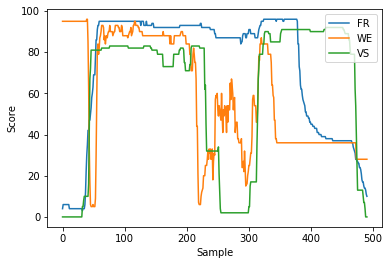

In [145]:
plt.plot(scores[0][test_segment], label='FR');
plt.plot(scores[1][test_segment], label='WE');
plt.plot(scores[2][test_segment], label='VS');
plt.ylabel('Score')
plt.xlabel('Sample')
plt.legend(loc='upper right')
plt.show();

In [146]:
# prepare for training
dataset = {i: [] for i in range(n_cluster)}
bgn = 0
for enum, score in enumerate(zip(*scores)):
    if enum == test_segment:
        continue
    # segment points
    seg = np.array(score).T
    # find end then slice
    end = bgn + seg.shape[0]
    cluster_member = est.labels_[bgn:end]
    # for every cluster
    for i in range(n_cluster):
        # get index 
        sequence = np.where(cluster_member == i)[0]
        # must be 2 or more
        if sequence.shape[0] < 2:
            continue
        ptr = sequence[0]
        for idx in sequence[1:]:
            if idx - ptr != 1:
                # not adjacent
                i_member = seg[ptr:idx]
                if i_member.shape[0] > 1:
                    # len is 2 or more
                    dataset[i].append(i_member)
                ptr = idx
    bgn = end
for k, v in dataset.items():
    if len(v) == 0:
        print(k, 'has no member')

In [147]:
%%time

# 0 bunker, 1 wind effect, 2 distance
hidden_param = 0
observable_param = 2
# hidden: to be predicted
# observable: input

# hmm = {}
# for i in tqdm(range(n_cluster), total=n_cluster):
#     pi = util.generate_initial_proba([seg[:, hidden_param] for seg in dataset[i]], n_class)
#     hidden = util.generate_hidden_matrix([seg[:, hidden_param] for seg in dataset[i]], n_class)
#     _, observable = util.generate_observable_matrix([seg[:, hidden_param] for seg in dataset[i]], 
#                                                     [seg[:, observable_param] for seg in dataset[i]], 
#                                                     n_class, i)
#     # hmm[i] = pi, hidden, gaussian_filter(observable, sigma=0.5)
#     hmm[i] = pi, hidden, observable


hmm = {}
pi, hidden, observable = [], [], []
with ProcessPoolExecutor() as executor:
    wait_for_1, wait_for_2, wait_for_3 = [], [], []
    for i in range(n_cluster):
        wait_for_1.append(executor.submit(util.generate_initial_proba, [seg[:, hidden_param] for seg in dataset[i]], n_class, i))
        wait_for_2.append(executor.submit(util.generate_hidden_matrix, [seg[:, hidden_param] for seg in dataset[i]], n_class, i))
        wait_for_3.append(executor.submit(util.generate_observable_matrix, [seg[:, hidden_param] for seg in dataset[i]], 
                                                                           [seg[:, observable_param] for seg in dataset[i]], 
                                                                           n_class, i))
    for f in tqdm(as_completed(wait_for_1), total=len(wait_for_1)):
        pi.append(f.result())
    for f in as_completed(wait_for_2):
        hidden.append(f.result())
    for f in as_completed(wait_for_3):
        observable.append(f.result())
pi = list(map(itemgetter(1), sorted(pi, key=itemgetter(0))))
hidden = list(map(itemgetter(1), sorted(hidden, key=itemgetter(0))))
observable = list(map(itemgetter(1), sorted(observable, key=itemgetter(0))))
for i, zipped in enumerate(zip(pi, hidden, observable)):
    hmm[i] = zipped

100%|██████████| 350/350 [00:25<00:00, 13.93it/s]
CPU times: user 1.52 s, sys: 1.38 s, total: 2.89 s
Wall time: 27.3 s


In [148]:
# prediction

In [149]:
# some var names are recycled

score = np.array([scores[i][test_segment] for i in range(3)])
# cluster_member = util.get_cluster_member(score, est.cluster_centers_)
cluster_member = est.predict(score.T)

level = cluster_member[0]
cluster_member_segments, one_level = [], [level]
for i in range(1, cluster_member.shape[0]):
    if cluster_member[i] == level:
        one_level.append(cluster_member[i])
    else:
        cluster_member_segments.append(one_level)
        level = cluster_member[i]
        one_level = [level]
if len(one_level) > 0:
    cluster_member_segments.append(one_level)

path, bgn = [], 0
for one_level in cluster_member_segments:
    end = bgn + len(one_level)
    # pi, hidden, observable = (gaussian_filter(p, sigma=0.5) for p in hmm[one_level[0]])
    pi, hidden, observable = hmm[one_level[0]]
    observable = gaussian_filter(observable, sigma=0.5)
    p, *_ = util.viterbi(pi, hidden, observable, scores[2][test_segment][bgn:end])
    path.extend(p)
    bgn = end

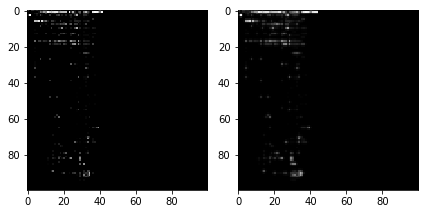

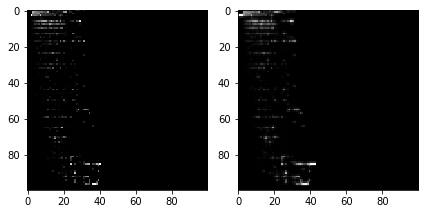

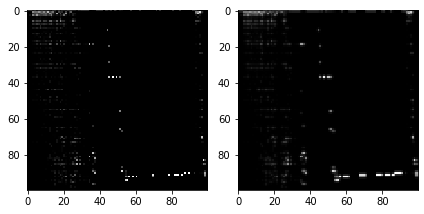

In [161]:
# 0:pi
# 1:hidden
# 2:observable
which_matrix = 2

for one_level in cluster_member_segments[-3:]:
    matrix = hmm[one_level[0]][which_matrix]
    plt.subplot(1, 2, 1)
    plt.imshow(255*normalize(matrix).T, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.imshow(255*normalize(gaussian_filter(matrix, sigma=0.5)).T, cmap='gray')
    plt.tight_layout()
    plt.show();

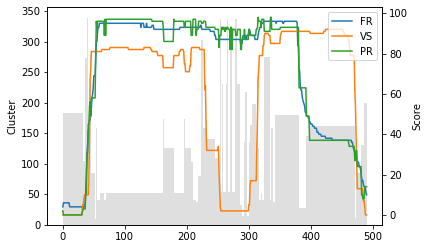

In [151]:
if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member)), cluster_member, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='VS');
plt.xlabel('Sample')
plt.plot(path, label='PR');
plt.legend(loc='upper right');
plt.show();

In [152]:
auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path)), path)
auc_diff = (auc_pred - auc_truth) / auc_truth
print('AUC (area under curve) difference from ground truth: {:.2f} %'.format(100 * auc_diff))

AUC (area under curve) difference from ground truth: 0.12 %


In [153]:
test_segment

8

In [154]:
import util
import pickle

In [155]:
with open('scores.pkl', 'rb') as f:
    signals, scores, estimators = pickle.load(f)

n_class = 100

In [170]:
accuracies = util.test_all_segments(scores, n_class, n_cluster=350, is_plot=False)

number of segments: 1002 

#   0 |  47 seconds | 350 clusters | off by:  -77.9 %

#   1 |  45 seconds | 350 clusters | off by:  -30.2 %



KeyboardInterrupt: 

In [ ]:
with open('accuracies.pkl', 'wb') as f:
    pickle.dump(accuracies, f)